In [1]:
from geosnap import datasets, Community
import geopandas as gpd
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import segregation
import libpysal
import esda

In [28]:
from geopandas_view import view

In [7]:
dc = Community.from_census(msa_fips='47900', years=2010)

In [8]:
gdf = dc.gdf

We can read school and attendance boundary data right into memory (though, to use these data repeatedly with better performance, we could write the dataframes out to disk)

In [6]:
schools = gpd.read_parquet('s3://spatial-ucr/nces/schools/schools_1516.parquet')

In [18]:
attzones = gpd.read_parquet('s3://spatial-ucr/nces/sabs/sabs_1516.parquet')

In [10]:
schools = schools.to_crs(gdf.crs)

In [19]:
attzones = attzones.to_crs(gdf.crs)

In [14]:
schools = schools[schools.intersects(gdf.unary_union)]

<AxesSubplot:>

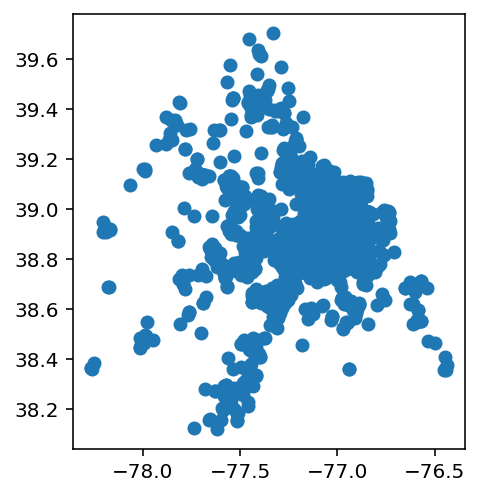

In [15]:
schools.plot()

In [20]:
attzones = attzones[attzones.representative_point().intersects(gdf.unary_union)]

<AxesSubplot:>

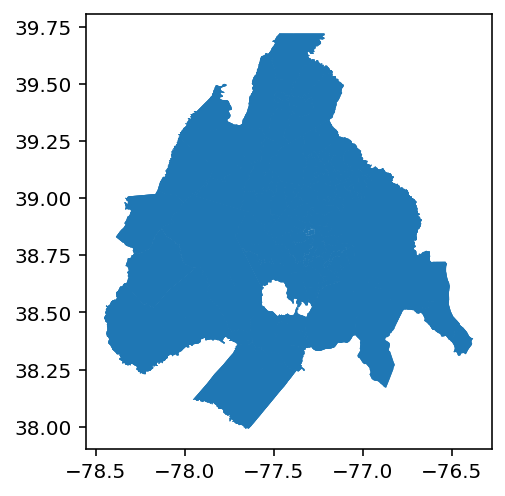

In [21]:
attzones.plot()

In [25]:
elem_zones = attzones[attzones.level=='1']

In [26]:
elem_zones.head()

,SrcName,ncessch,schnam,leaid,gslo,gshi,defacto,stAbbrev,openEnroll,Shape_Leng,Shape_Area,level,MultiBdy,geometry
13798,Murch,110003000001,Murch ES,1100030,PK,05,0,DC,0,13392.930112,8.143446e+06,1,0,"POLYGON ((-77.04929 38.96105, -77.04922 38.961..."
13799,Moten,110003000002,Moten ES,1100030,PK,05,0,DC,0,6396.010854,1.796545e+06,1,0,"POLYGON ((-76.97997 38.86161, -76.97950 38.860..."
13800,Miner,110003000004,Miner ES,1100030,PK,05,0,DC,0,8838.615454,2.746101e+06,1,0,"POLYGON ((-76.98446 38.90034, -76.98414 38.900..."
13802,Takoma,110003000011,Takoma EC,1100030,PK,08,0,DC,0,8962.771241,3.356578e+06,1,0,"POLYGON ((-77.00849 38.97038, -77.00902 38.969..."
13803,Stanton,110003000013,Stanton ES,1100030,PK,05,0,DC,0,6729.767024,2.000036e+06,1,0,"POLYGON ((-76.96762 38.86371, -76.96753 38.863..."


In [29]:
view(elem_zones)

In [37]:
#scores = pd.read_csv("/Users/knaaptime/Downloads/seda_school_pool_gcs_v30.csv", converters={'ncessch':str})

In [51]:
scores = pd.read_csv('https://stacks.stanford.edu/file/druid:db586ns4974/seda_school_pool_gcs_4.0.csv')

In [52]:
scores.head()

,sedasch,sedaschname,fips,stateabb,subcat,subgroup,gradecenter,gap,tot_asmts,cellcount,...,gcs_mn_grd_ol_se,gcs_mn_mth_ol_se,gcs_mn_avg_eb,gcs_mn_coh_eb,gcs_mn_grd_eb,gcs_mn_mth_eb,gcs_mn_avg_eb_se,gcs_mn_coh_eb_se,gcs_mn_grd_eb_se,gcs_mn_mth_eb_se
0,10000201667,Camps,1,AL,all,all,7.5,0,13,2,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,10000201670,Det Ctr,1,AL,all,all,7.5,0,2,1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,10000201705,Wallace Sch - Mt Meigs Campus,1,AL,all,all,7.0,0,98,12,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,10000201706,McNeel Sch - Vacca Campus,1,AL,all,all,7.0,0,118,12,...,NaN,NaN,2.632403,NaN,NaN,NaN,0.469368,NaN,NaN,NaN
4,10000500870,Albertville Middle School,1,AL,all,all,7.5,0,12520,39,...,NaN,0.16536,6.363105,-0.026981,NaN,-0.256272,0.082592,0.027416,NaN,0.155361


In [53]:
scores.sedasch = scores.sedasch.astype(str)

In [54]:
school_scores = schools.merge(scores, left_on='NCESSCH', right_on='sedasch', how='left')

### School Mean Achievement (grade cohort standardized)

In [71]:
view(school_scores.dropna(subset=['gcs_mn_avg_eb']), column='gcs_mn_avg_eb',scheme='quantiles', cmap='YlOrBr', tooltip=['gcs_mn_avg_eb'], marker_type='circle_marker', marker_kwds={"radius": 5, "fill": True}, tiles="Stamen Toner")

## The Spatial Structure of Educational Performance

## DC Metro

### Address-Based

In [73]:
school_scores = school_scores.dropna(subset=['gcs_mn_avg_eb', 'geometry'])

In [74]:
school_scores = school_scores.to_crs(2248)

In [96]:
w = libpysal.weights.KNN.from_dataframe(school_scores, k=5)

In [76]:
from splot.esda import moran_scatterplot, lisa_cluster, plot_moran, plot_local_autocorrelation
from splot.libpysal import plot_spatial_weights

In [78]:
m = esda.Moran(school_scores.gcs_mn_avg_eb, w)

In [79]:
mse = esda.Moran(school_scores.gcs_mn_avg_eb_se, w)

(<Figure size 720x288 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Reference Distribution'}, xlabel='Moran I: 0.42', ylabel='Density'>,
        <AxesSubplot:title={'center':'Moran Scatterplot (0.42)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

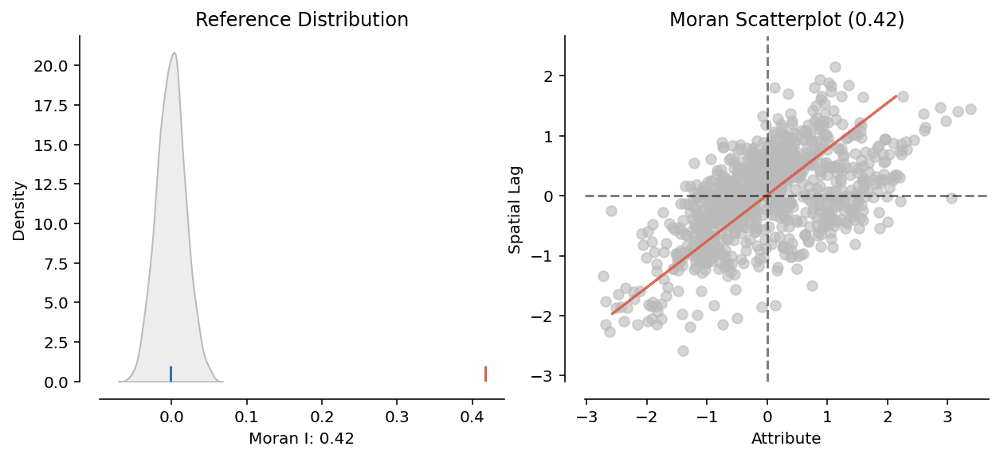

In [80]:
plot_moran(m)

(<Figure size 720x288 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Reference Distribution'}, xlabel='Moran I: 0.05', ylabel='Density'>,
        <AxesSubplot:title={'center':'Moran Scatterplot (0.05)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

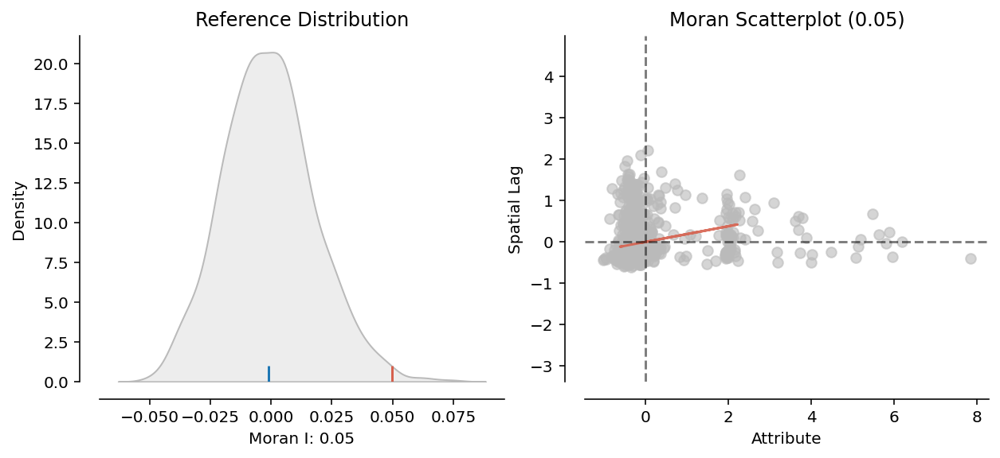

In [81]:
plot_moran(mse)

In [82]:
m.p_sim

0.001

Significant spatial autocorrelation in both the scores *and* the residual

In [83]:
mse.p_sim

0.006

In [111]:
mloc=esda.Moran_Local(school_scores.gcs_mn_avg_eb.values, w)

In [86]:
mlocse=esda.Moran_Local(school_scores.gcs_mn_avg_eb_se.values, w)

### Hotspots of educational performance

(<Figure size 1080x288 with 3 Axes>,
 array([<AxesSubplot:title={'center':'Moran Local Scatterplot'}, xlabel='Attribute', ylabel='Spatial Lag'>,
        <AxesSubplot:>, <AxesSubplot:>], dtype=object))

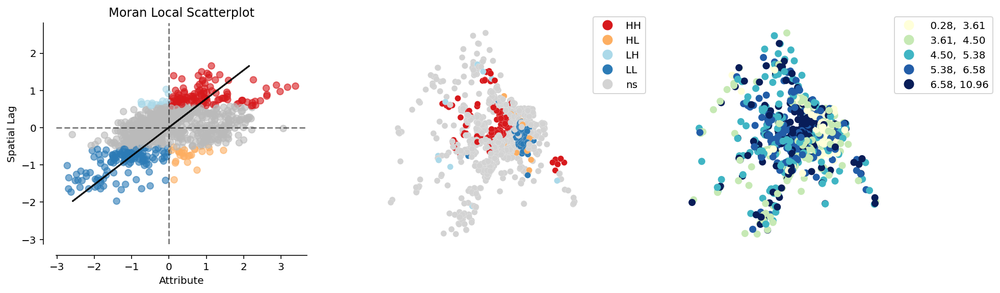

In [87]:
plot_local_autocorrelation(mloc, school_scores, school_scores.gcs_mn_avg_eb)

There are also significant hot and cold spots wrt school scores (and error, interestingly). The clusters are as we might expect: hotspots in bethesda/potomac, coldspots in east DC and PG county

In [116]:
view(school_scores.assign(i=mloc.q), column='i', categorical=True, tooltip=['NAME'],cmap='RdBu', marker_type='circle_marker', marker_kwds={"radius": 5, "fill": True}, tiles="Stamen Toner")

### Hotspots of *change* in educational achievement

In [93]:
school_scores = school_scores.dropna(subset=['gcs_mn_coh_eb'])

In [97]:
mloc_slope=esda.Moran_Local(school_scores.gcs_mn_coh_eb.values, w)

(<Figure size 1080x288 with 3 Axes>,
 array([<AxesSubplot:title={'center':'Moran Local Scatterplot'}, xlabel='Attribute', ylabel='Spatial Lag'>,
        <AxesSubplot:>, <AxesSubplot:>], dtype=object))

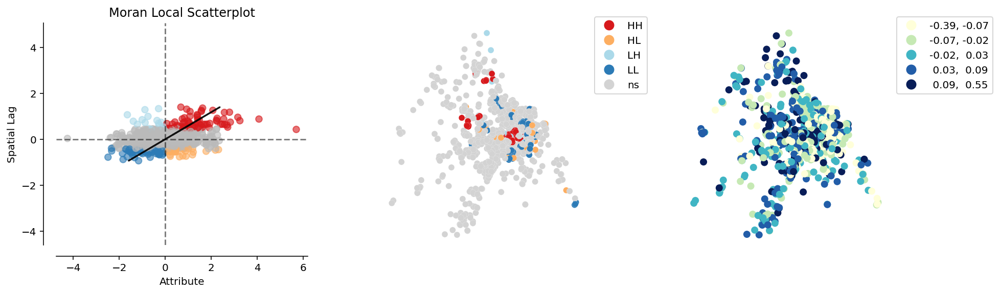

In [98]:
plot_local_autocorrelation(mloc_slope, school_scores, school_scores.gcs_mn_coh_eb)

In [125]:
view(school_scores.assign(slope_i=mloc_slope.q), column='slope_i', categorical=True,cmap='RdBu', tooltip=['NAME'], marker_type='circle_marker', marker_kwds={"radius": 5, "fill": True}, tiles="Stamen Toner")

## Attendance Zone-based

In [38]:
zones = attzones.merge(scores, on='ncessch', how='inner')

In [39]:
zones = zones.dropna(subset=['mn_avg_eb'])

In [40]:
w_cont = libpysal.weights.Queen.from_dataframe(zones)

In [41]:
m_zone = esda.Moran(zones.mn_avg_eb, w_cont)

(<Figure size 720x288 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Reference Distribution'}, xlabel='Moran I: 0.68', ylabel='Density'>,
        <AxesSubplot:title={'center':'Moran Scatterplot (0.68)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

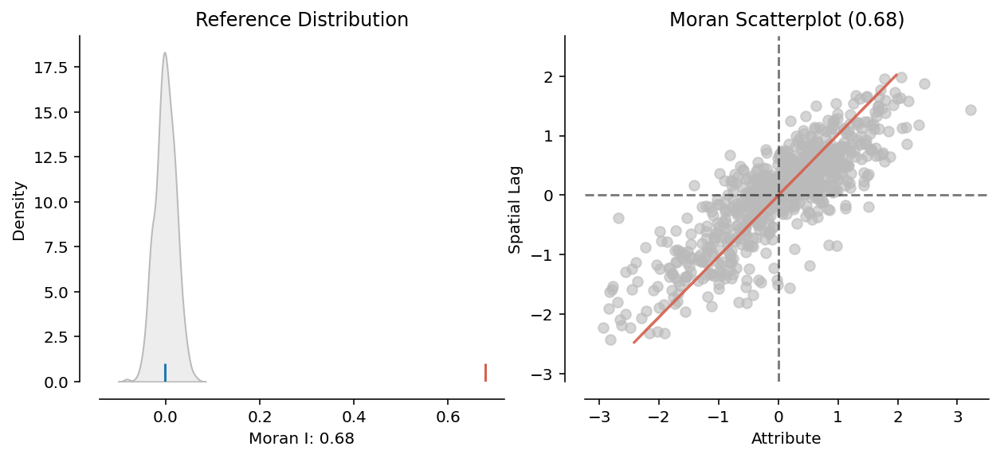

In [42]:
plot_moran(m_zone)

so we've got significant autocorrelation at the school level and the attendance zone level

## National

In [18]:
allschools = gpd.read_file('/Users/knaaptime/Downloads/EDGE_GEOCODE_PUBLICSCH_1819/Shapefile_SCH/EDGE_GEOCODE_PUBLICSCH_1819.shp')

In [19]:
all_scores = pd.read_csv("/Users/knaaptime/Downloads/seda_school_pool_gcs_v30.csv", converters={'ncessch':str})

In [20]:
all_scores.ncessch = all_scores.ncessch.str.rjust(12, '0')

In [17]:
from geosnap import datasets

In [117]:
states = datasets.states()

In [21]:
allschools = allschools.merge(all_scores, left_on='NCESSCH', right_on='ncessch', how='left')

In [22]:
allschoools = allschools.dropna(subset=['mn_avg_eb', 'geometry'])

In [23]:
#allschools.plot()

In [24]:
allschools = allschools[~allschools.STATE.isin(['PR', 'AK', "HI", 'GU', 'AS', 'VI'])]

In [25]:
allschools.STATE.unique()

array(['AL', 'AZ', 'AR', 'CA', 'CO', 'CT', 'DE', 'DC', 'MD', 'FL', 'GA',
       'ID', 'OR', 'IL', 'IN', 'IA', 'KS', 'KY', 'LA', 'ME', 'MA', 'MI',
       'MN', 'MS', 'MO', 'MT', 'NE', 'NV', 'NH', 'NJ', 'NM', 'NY', 'NC',
       'ND', 'OH', 'OK', 'PA', 'RI', 'SC', 'SD', 'TN', 'TX', 'UT', 'VT',
       'VA', 'WA', 'WV', 'WI', 'WY'], dtype=object)

<AxesSubplot:>

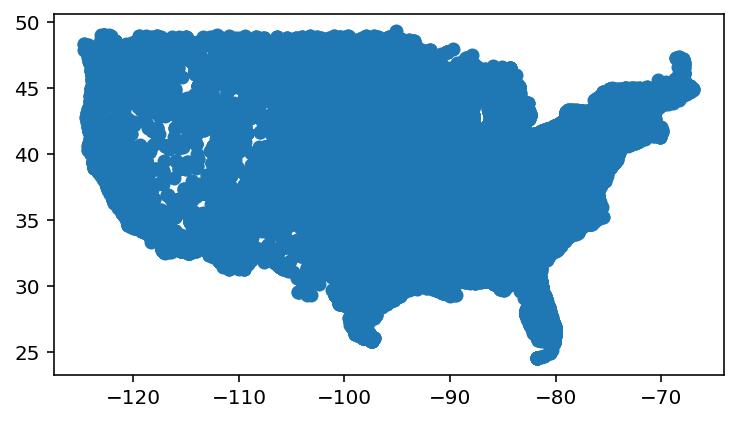

In [65]:
allschools.plot()

In [26]:
allschools = allschools.to_crs('ESRI:102005')

In [27]:
allschools = allschools.dropna(subset=['mn_avg_eb', 'geometry'])

In [72]:
w_all = libpysal.weights.KNN.from_dataframe(allschools, k=5)

/Users/knaaptime/anaconda3/envs/geosnap/lib/python3.8/site-packages/libpysal/weights/weights.py:172: UserWarning: The weights matrix is not fully connected: 
 There are 55 disconnected components.
  warnings.warn(message)


In [73]:
moranall = esda.Moran(allschools.mn_avg_eb, w_all)

(<Figure size 720x288 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Reference Distribution'}, xlabel='Moran I: 0.62', ylabel='Density'>,
        <AxesSubplot:title={'center':'Moran Scatterplot (0.62)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

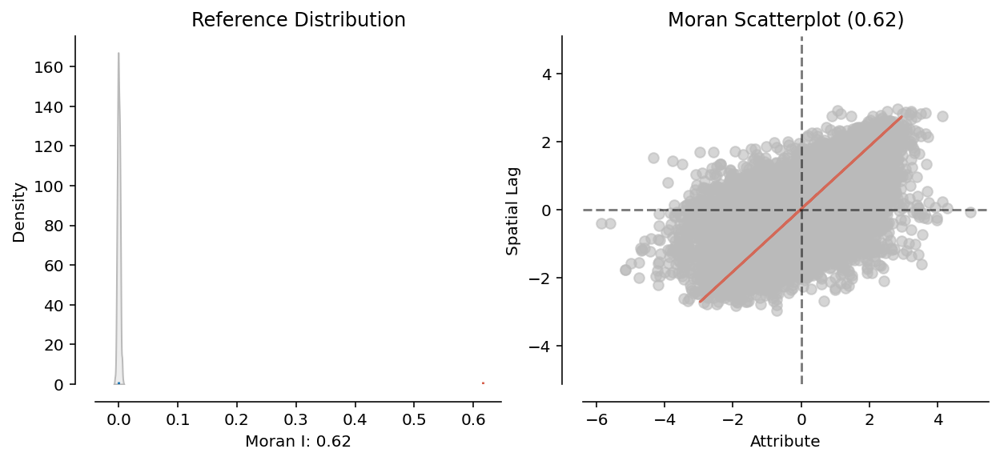

In [74]:
plot_moran(moranall)

In [75]:
mnationalloc=esda.Moran_Local(allschools.mn_avg_eb.values, w_all)

(<Figure size 1080x288 with 3 Axes>,
 array([<AxesSubplot:title={'center':'Moran Local Scatterplot'}, xlabel='Attribute', ylabel='Spatial Lag'>,
        <AxesSubplot:>, <AxesSubplot:>], dtype=object))

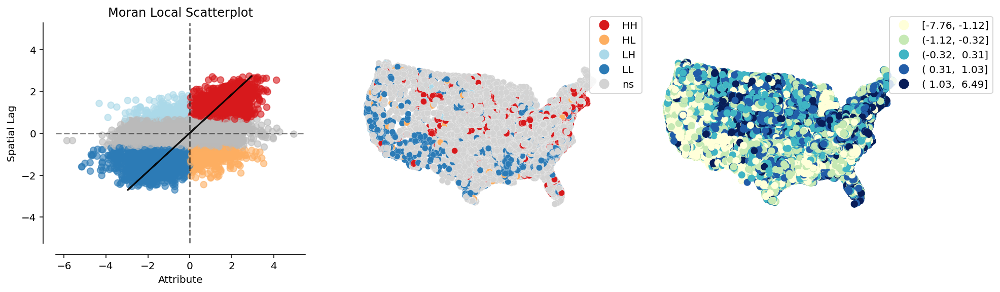

In [76]:
plot_local_autocorrelation(mnationalloc, allschools, allschools.mn_avg_eb)

In [113]:
state_schools = allschools.groupby('STATE').median()

In [114]:
state_schools.fips = state_schools.fips.astype(int).astype(str).str.rjust(2, '0')

In [118]:
states = states.merge(state_schools, how='left', left_on='geoid', right_on='fips')

In [119]:
states = states.dropna(subset=['mn_avg_eb'])

In [105]:
w_state = libpysal.weights.Queen.from_dataframe(states)

<AxesSubplot:>

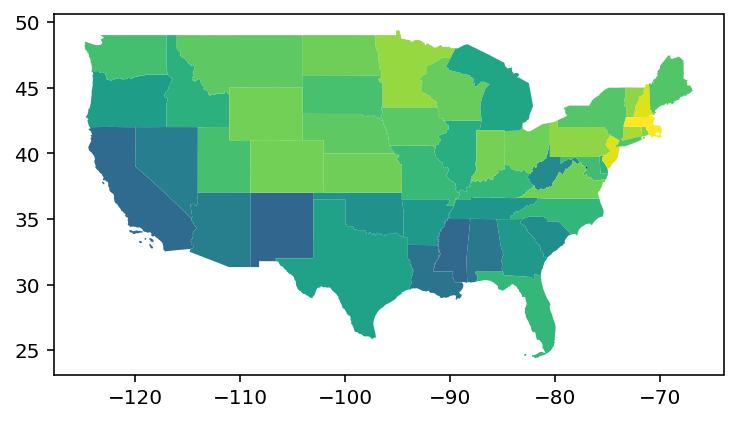

In [120]:
states.plot('mn_avg_eb')

In [121]:
statemoran = esda.Moran(states.mn_avg_eb, w_state)

(<Figure size 720x288 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Reference Distribution'}, xlabel='Moran I: 0.36', ylabel='Density'>,
        <AxesSubplot:title={'center':'Moran Scatterplot (0.36)'}, xlabel='Attribute', ylabel='Spatial Lag'>],
       dtype=object))

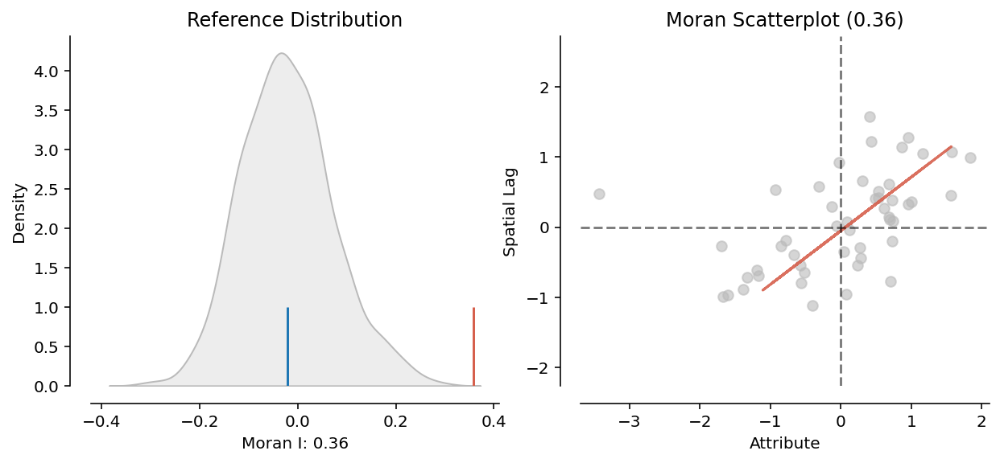

In [122]:
plot_moran(statemoran)

In [123]:
mloc_states=esda.Moran_Local(states.mn_avg_eb_se.values, w_state)

(<Figure size 1080x288 with 3 Axes>,
 array([<AxesSubplot:title={'center':'Moran Local Scatterplot'}, xlabel='Attribute', ylabel='Spatial Lag'>,
        <AxesSubplot:>, <AxesSubplot:>], dtype=object))

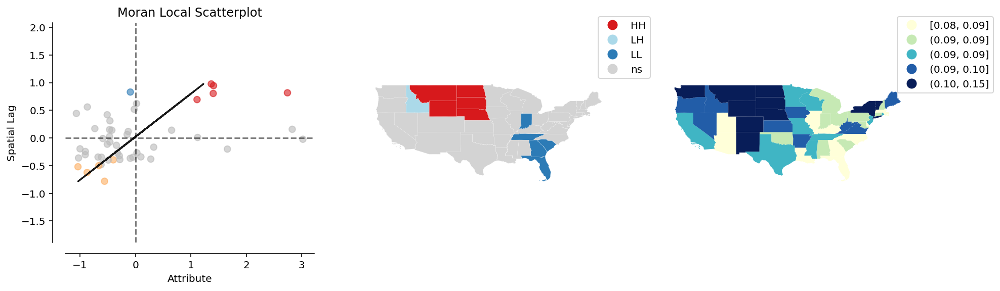

In [124]:
plot_local_autocorrelation(mloc_states, states, states.mn_avg_eb_se)

So we've got significant autocorrelation at multiple spatial scales...

We also get slightly different results if we take mean vs median

# Education & Segregation

In [7]:
import pandas as pd

In [8]:
from urllib.request import urlopen
from json import loads
url = "https://educationdata.urban.org/api/v1/schools/crdc/enrollment/2013/race/sex/"
response = urlopen(url)
data = loads(response.read())

In [22]:
def get_education(dataset=None, year=None):
    
    url = f"https://educationdata.urban.org/api/v1/schools/{dataset}/enrollment/{year}/race/sex/"
    response = urlopen(url)
    data = loads(response.read())
    df = pd.DataFrame.from_records(data['results'])
    
    if 'race' in filters:
    
    race_cols = {1: 'White',
                    2:'Black',
                    3:'Hispanic',
                    4:'Asian',
                    5:'American Indian or Alaska Native',
                    6:'Native Hawaiian or other Pacific Islander',
                    7:'Two or more races',
                    8:'Nonresident alien',
                    9:'Unknown',
                    20:'Other',
                    99:'Total'}

        race = df.pivot_table(columns=['race'], values='enrollment_crdc', index='crdc_id', aggfunc='sum')
        race = race.rename(columns=race_cols)
        race = race.reset_index()
    elif:
        sex in filters:
            
    return race

In [25]:
race13 = get_education(dataset='crdc', year=2013)

In [19]:
race15 = get_education(2015)

In [21]:
for year in range(2010,2020):
    try:
        race = get_education(year)
    except Exception:
        print(f"{year} failed")

2010 failed
2012 failed
2014 failed
2016 failed
2017 failed
2018 failed
2019 failed


In [20]:
race15

race,crdc_id,White,Black,Hispanic,Asian,American Indian or Alaska Native,Native Hawaiian or other Pacific Islander,Two or more races,Total
0,010123000447,158.0,776.0,62.0,14.0,4.0,4.0,20.0,1038.0
1,040063303106,182.0,44.0,338.0,0.0,8.0,0.0,26.0,598.0
2,060015310932,4.0,0.0,110.0,20.0,0.0,0.0,4.0,138.0
3,062640003989,8.0,8.0,638.0,56.0,0.0,14.0,20.0,744.0
4,06CC43300001,56.0,44.0,74.0,8.0,0.0,0.0,14.0,196.0
5,080249006557,44.0,0.0,8.0,0.0,0.0,0.0,4.0,56.0
6,080447001600,458.0,4.0,116.0,8.0,4.0,0.0,4.0,594.0
7,100068000082,362.0,278.0,512.0,14.0,8.0,0.0,10.0,1184.0
8,120108001123,1424.0,104.0,386.0,8.0,4.0,0.0,44.0,1970.0
9,120108001128,464.0,650.0,518.0,56.0,4.0,4.0,50.0,1746.0


In [18]:
race13

race,crdc_id,White,Black,Hispanic,Asian,American Indian or Alaska Native,Native Hawaiian or other Pacific Islander,Two or more races,Total
0,040081199996,134.0,4.0,62.0,4.0,8.0,0.0,0.0,212.0
1,060001909274,68.0,20.0,56.0,8.0,0.0,0.0,8.0,160.0
2,060162000013,0.0,8.0,800.0,8.0,0.0,8.0,0.0,824.0
3,061488001851,44.0,8.0,242.0,380.0,0.0,8.0,116.0,798.0
4,090474000959,554.0,20.0,134.0,32.0,0.0,0.0,8.0,748.0
5,100008000024,1556.0,788.0,164.0,92.0,14.0,0.0,26.0,2640.0
6,120039003558,NaN,20.0,2378.0,32.0,4.0,0.0,NaN,681.0
7,170017002342,0.0,26.0,8.0,0.0,0.0,0.0,4.0,38.0
8,170993005788,4.0,68.0,614.0,0.0,4.0,0.0,0.0,690.0
9,171242001493,0.0,728.0,14.0,0.0,4.0,0.0,4.0,750.0


In [30]:
df = pd.DataFrame.from_records(data['results'])

In [31]:
df.columns

Index(['crdc_id', 'ncessch', 'year', 'fips', 'leaid', 'race', 'sex',
       'disability', 'lep', 'enrollment_crdc'],
      dtype='object')

In [5]:
df

NameError: name 'df' is not defined

In [33]:
df.info() # we're only getting back 1000 rows until we can figure out the max records param from UI's API

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 10 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   crdc_id          1000 non-null   object
 1   ncessch          1000 non-null   object
 2   year             1000 non-null   int64 
 3   fips             1000 non-null   int64 
 4   leaid            1000 non-null   int64 
 5   race             1000 non-null   int64 
 6   sex              1000 non-null   int64 
 7   disability       1000 non-null   int64 
 8   lep              1000 non-null   int64 
 9   enrollment_crdc  1000 non-null   int64 
dtypes: int64(8), object(2)
memory usage: 78.2+ KB


In [34]:
df.pivot(columns=['race', 'sex'], values='enrollment_crdc', index='crdc_id')

race           5                4                    2                    3   \
sex            2    1     99    2      1      99     2      1      99     2    
crdc_id                                                                        
040081199996  2.0  2.0   4.0   0.0    2.0    2.0    0.0    2.0    2.0   14.0   
060001909274  0.0  0.0   0.0   2.0    2.0    4.0    5.0    5.0   10.0    8.0   
060162000013  0.0  0.0   0.0   2.0    2.0    4.0    2.0    2.0    4.0  200.0   
061488001851  0.0  0.0   0.0  80.0  110.0  190.0    2.0    2.0    4.0   50.0   
090474000959  0.0  0.0   0.0  11.0    5.0   16.0    8.0    2.0   10.0   32.0   
100008000024  2.0  5.0   7.0  23.0   23.0   46.0  182.0  212.0  394.0   50.0   
120039003558  2.0  0.0   2.0   8.0    8.0   16.0    5.0    5.0   10.0  629.0   
170017002342  0.0  0.0   0.0   0.0    0.0    0.0    2.0   11.0   13.0    2.0   
170993005788  2.0  0.0   2.0   0.0    0.0    0.0   14.0   20.0   34.0  152.0   
171242001493  0.0  2.0   2.0   0.0    0.0    0.0  179.0  185.0  364.0    2.0   
171356001648  0.0  2.0   2.0   2.0    2.0    4.0    5.0    2.0    7.0    8.0   
180897001494  0.0  2.0   2.0  32.0   23.0   55.0   20.0   23.0   43.0   35.0   
191575000941  0.0  0.0   0.0   0.0    0.0    0.0    0.0    2.0    2.0    0.0   
200996002053  2.0  0.0   2.0   0.0    0.0    0.0    2.0    5.0    7.0    2.0   
201143001074  2.0  2.0   4.0   0.0    2.0    2.0    0.0    2.0    2.0   11.0   
210459001135  0.0  0.0   0.0   2.0    2.0    4.0   11.0   11.0   22.0   17.0   
220036000285  0.0  0.0   0.0   0.0    0.0    0.0   26.0   20.0   46.0    2.0   
240048000503  2.0  0.0   2.0  26.0   41.0   67.0   23.0   29.0   52.0   53.0   
250462000984  0.0  2.0   2.0   8.0    2.0   10.0   11.0   14.0   25.0   11.0   
260990004478  0.0  0.0   0.0   5.0    2.0    7.0    2.0    5.0    7.0    2.0   
270010200134  0.0  0.0   0.0   2.0    2.0    4.0    0.0    0.0    0.0   23.0   
280219000396  0.0  0.0   0.0   0.0    0.0    0.0  422.0  386.0  808.0    0.0   
280357000689  0.0  0.0   0.0   0.0    0.0    0.0   35.0   38.0   73.0    2.0   
290000903077  0.0  0.0   0.0   0.0    0.0    0.0   14.0    0.0   14.0    0.0   
360327000092  0.0  0.0   0.0  14.0   11.0   25.0    8.0    8.0   16.0   29.0   
360846000645  0.0  0.0   0.0   2.0    0.0    2.0    8.0    5.0   13.0    2.0   
361086000856  0.0  0.0   0.0   2.0    0.0    2.0    0.0    2.0    2.0    2.0   
361245001011  0.0  0.0   0.0   2.0    2.0    4.0    2.0    2.0    4.0    2.0   
390437100249  2.0  2.0   4.0   2.0    0.0    2.0   89.0  110.0  199.0   11.0   
420450004195  0.0  0.0   0.0   0.0    0.0    0.0    2.0    8.0   10.0    0.0   
422043000295  0.0  0.0   0.0   2.0    2.0    4.0    2.0    2.0    4.0    2.0   
422277001359  0.0  0.0   0.0  32.0   23.0   55.0    8.0    5.0   13.0    8.0   
470318002136  0.0  0.0   0.0   0.0    0.0    0.0   71.0   32.0  103.0    8.0   
480008208437  0.0  0.0   0.0   2.0    0.0    2.0   53.0   53.0  106.0   35.0   
481473011987  0.0  0.0   0.0   2.0    0.0    2.0    2.0    2.0    4.0   41.0   
482442002732  5.0  8.0  13.0   2.0    5.0    7.0   23.0   23.0   46.0  344.0   
482850010917  2.0  0.0   2.0  11.0   14.0   25.0   11.0    5.0   16.0   47.0   
484578005218  2.0  2.0   4.0  14.0   11.0   25.0   35.0   29.0   64.0   86.0   
510366002320  2.0  2.0   4.0   8.0   11.0   19.0  119.0  101.0  220.0   95.0   
530696001023  2.0  2.0   4.0   2.0    0.0    2.0    0.0    2.0    2.0   20.0   
540060000397  0.0  0.0   0.0  47.0   32.0   79.0   35.0   47.0   82.0    2.0   
540066001484  0.0  0.0   0.0   0.0    0.0    0.0    0.0    2.0    2.0    2.0   

race          ...   6      99                   7                  1          \
sex           ...   99     2      1       99    2     1     99     2      1    
crdc_id       ...                                                              
040081199996  ...  0.0   45.0   61.0   106.0   0.0   0.0   0.0   29.0   38.0   
060001909274  ...  0.0   28.0   52.0    80.0   2.0   2.0   4.0   11.0   23.0   

In [35]:
race = df.pivot_table(columns=['race'], values='enrollment_crdc', index='crdc_id', aggfunc='sum')

In [36]:
race_cols = {1: 'White',
2:'Black',
3:'Hispanic',
4:'Asian',
5:'American Indian or Alaska Native',
6:'Native Hawaiian or other Pacific Islander',
7:'Two or more races',
8:'Nonresident alien',
9:'Unknown',
20:'Other',
99:'Total'}

In [37]:
race = race.rename(columns=race_cols)

In [38]:
race = race.reset_index()

In [39]:
race.head()

race,crdc_id,White,Black,Hispanic,Asian,American Indian or Alaska Native,Native Hawaiian or other Pacific Islander,Two or more races,Total
0,040081199996,134.0,4.0,62.0,4.0,8.0,0.0,0.0,212.0
1,060001909274,68.0,20.0,56.0,8.0,0.0,0.0,8.0,160.0
2,060162000013,0.0,8.0,800.0,8.0,0.0,8.0,0.0,824.0
3,061488001851,44.0,8.0,242.0,380.0,0.0,8.0,116.0,798.0
4,090474000959,554.0,20.0,134.0,32.0,0.0,0.0,8.0,748.0


In [ ]:
def collect_ui_data(**kwargs):
    base_url = f"https://educationdata.urban.org/api/v1/{geo_level}/{data_source}/{endpoint}/{year}"
    
    response = urlopen(url)
    data = loads(response.read())
    


In [113]:
school_by_race = allschools.merge(race, left_on='NCESSCH', right_on='crdc_id', how='inner')

In [41]:
attzones = gpd.read_file('/Users/knaaptime/Downloads/SABS_1516_SchoolLevels/SABS_1516_Primary.shp')

In [114]:
school_by_race = school_by_race.merge(attzones, on='ncessch', how='inner')

In [115]:
school_by_race = school_by_race.set_geometry('geometry_y')

<AxesSubplot:>

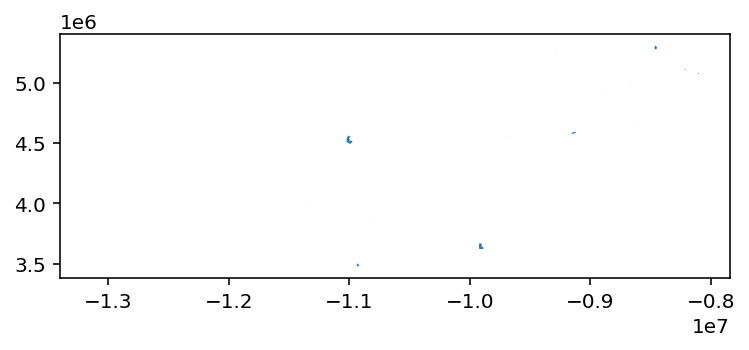

In [116]:
school_by_race.plot()

In [117]:
school_by_race['pct_blk'] = school_by_race.Black / school_by_race.Total

In [46]:
from tobler.area_weighted import area_interpolate

In [47]:
tracts = datasets.tracts_2010()

In [118]:
school_by_race = school_by_race.to_crs(4326)

In [119]:
school_by_race['geometry'] = school_by_race.buffer(0)
school_by_race = school_by_race.set_geometry('geometry')

In [98]:
intrp = area_interpolate(source_df=tracts, target_df=school_by_race, intensive_variables=['p_nonhisp_black_persons'])

/Users/knaaptime/Dropbox/projects/tobler/tobler/area_weighted/area_interpolate.py:254: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  den = source_df[source_df.geometry.name].area.values
/Users/knaaptime/Dropbox/projects/tobler/tobler/util/util.py:28: UserWarning: nan values in variable: p_nonhisp_black_persons, replacing with 0
  warn(f"nan values in variable: {column}, replacing with 0")


In [101]:
intrp['id'] = school_by_race.ncessch

In [104]:
school_by_race = school_by_race.merge(intrp, left_on='ncessch', right_on='id')

In [124]:
school_by_race.pct_blk = school_by_race.pct_blk*100

In [111]:
school_by_race[['pct_blk', 'p_nonhisp_black_persons']].corr()

,pct_blk,p_nonhisp_black_persons
pct_blk,1.000000,0.993675
p_nonhisp_black_persons,0.993675,1.000000


In [ ]:
school_by_race[['pct_black', 'p_nonhisp_black_persons']].corr()

unsurprisingly, the school demographics (at least as measured by % black) largely match the attendance zone demographics

apart from demographics, though, one thing that geosnap and tobler allow us to do is measure the socioeconomic conditions in each attendance zone

In [120]:
intrp = area_interpolate(source_df=tracts, target_df=school_by_race, intensive_variables=['p_nonhisp_black_persons',  "median_household_income", 'median_home_value',
        "p_poverty_rate",
        "p_edu_college_greater",
        "p_unemployment_rate",])

/Users/knaaptime/Dropbox/projects/tobler/tobler/area_weighted/area_interpolate.py:254: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  den = source_df[source_df.geometry.name].area.values
/Users/knaaptime/Dropbox/projects/tobler/tobler/util/util.py:28: UserWarning: nan values in variable: p_nonhisp_black_persons, replacing with 0
  warn(f"nan values in variable: {column}, replacing with 0")
/Users/knaaptime/Dropbox/projects/tobler/tobler/util/util.py:28: UserWarning: nan values in variable: median_household_income, replacing with 0
  warn(f"nan values in variable: {column}, replacing with 0")
/Users/knaaptime/Dropbox/projects/tobler/tobler/util/util.py:28: UserWarning: nan values in variable: median_home_value, replacing with 0
  warn(f"nan values in variable: {column}, replacing with 0")
/Users/knaaptime/Dropbox/projects/tobler/tobler/util/util.py:28: 

In [121]:
intrp['id'] = school_by_race.ncessch

In [122]:
school_by_race = school_by_race.merge(intrp, left_on='ncessch', right_on='id')

In [125]:
school_by_race

,NCESSCH,LEAID,NAME,OPSTFIPS,STREET,CITY,STATE,ZIP,STFIP,CNTY,...,pct_blk,geometry_x,p_nonhisp_black_persons,median_household_income,median_home_value,p_poverty_rate,p_edu_college_greater,p_unemployment_rate,geometry_y,id
0,060162000013,0601620,Furgeson (Venn W.) Elementary,06,22215 Elaine Ave.,Hawaiian Gardens,CA,90716,06,06037,...,0.970874,"POLYGON ((-118.07195 33.82769, -118.07193 33.8...",1.033103,49654.240705,292385.183230,23.163851,9.172758,5.770767,"POLYGON ((-118.07195 33.82769, -118.07193 33.8...",060162000013
1,061488001851,0614880,Merton E. Hill Elementary,06,9681 11th St.,Garden Grove,CA,92844,06,06059,...,1.002506,"POLYGON ((-117.95496 33.75956, -117.95493 33.7...",0.212737,58824.778680,445965.034124,17.913260,16.906815,15.132448,"POLYGON ((-117.95496 33.75956, -117.95493 33.7...",061488001851
2,090474000959,0904740,Pond Hill School,09,299 Pond Hill Road,Wallingford,CT,06492,09,09009,...,2.673797,"POLYGON ((-72.82820 41.45054, -72.82769 41.450...",1.023580,95184.764883,343561.792618,5.779452,31.497393,5.365163,"POLYGON ((-72.82820 41.45054, -72.82769 41.450...",090474000959
3,171242001493,1712420,Berger-Vandenberg Elem School,17,14833 Avalon Ave,Dolton,IL,60419,17,17031,...,97.066667,"POLYGON ((-87.57908 41.62273, -87.57908 41.622...",85.529341,60051.544728,130524.394526,14.229787,19.740190,17.179871,"POLYGON ((-87.57908 41.62273, -87.57908 41.622...",171242001493
4,201143001074,2011430,Skyline Elem,20,20269 W Highway 54,Pratt,KS,67124,20,20151,...,0.636943,"MULTIPOLYGON (((-99.01531 37.64538, -99.01531 ...",0.589486,57471.196954,77980.997474,7.997637,21.965927,3.278562,"MULTIPOLYGON (((-99.01531 37.64538, -99.01531 ...",201143001074
5,210459001135,2104590,Newton Parrish Elementary School,21,510 Byers Ave,Owensboro,KY,42303,21,21059,...,5.152225,"POLYGON ((-87.08823 37.75497, -87.08698 37.755...",5.022030,41617.888700,109440.860842,16.822967,19.287741,7.413654,"POLYGON ((-87.08823 37.75497, -87.08698 37.755...",210459001135
6,260990004478,2609900,North Sashabaw Elementary School,26,5290 MAYBEE RD,CLARKSTON,MI,48346,26,26125,...,1.928375,"POLYGON ((-83.36329 42.70492, -83.36534 42.704...",0.968262,58020.991736,127565.541233,11.704834,20.802792,13.882721,"POLYGON ((-83.36329 42.70492, -83.36534 42.704...",260990004478
7,280357000689,2803570,PERRY CENTRAL MIDDLE SCHOOL,28,100 8th Ave. South,NEW AUGUSTA,MS,39462,28,28111,...,25.259516,"POLYGON ((-89.14561 31.25928, -89.01011 31.258...",30.639159,33912.264976,72398.320735,25.103741,4.899866,17.860826,"POLYGON ((-89.14561 31.25928, -89.01011 31.258...",280357000689
8,360327000092,3603270,NOXON ROAD ELEMENTARY SCHOOL,36,4 OLD NOXON RD,POUGHKEEPSIE,NY,12603,36,36027,...,3.970223,"POLYGON ((-73.78812 41.67244, -73.78841 41.671...",5.667957,100005.370086,364781.379376,4.398205,36.190245,11.739376,"POLYGON ((-73.78812 41.67244, -73.78841 41.671...",360327000092
9,360846000645,3608460,ALTON B PARKER SCHOOL,36,89 MADISON AVE,CORTLAND,NY,13045,36,36023,...,4.049844,"POLYGON ((-76.17223 42.60210, -76.17202 42.598...",1.819080,45999.001780,102878.635269,21.548058,32.638610,8.556866,"POLYGON ((-76.17223 42.60210, -76.17202 42.598...",360846000645


In [126]:
import seaborn as sns

<AxesSubplot:>

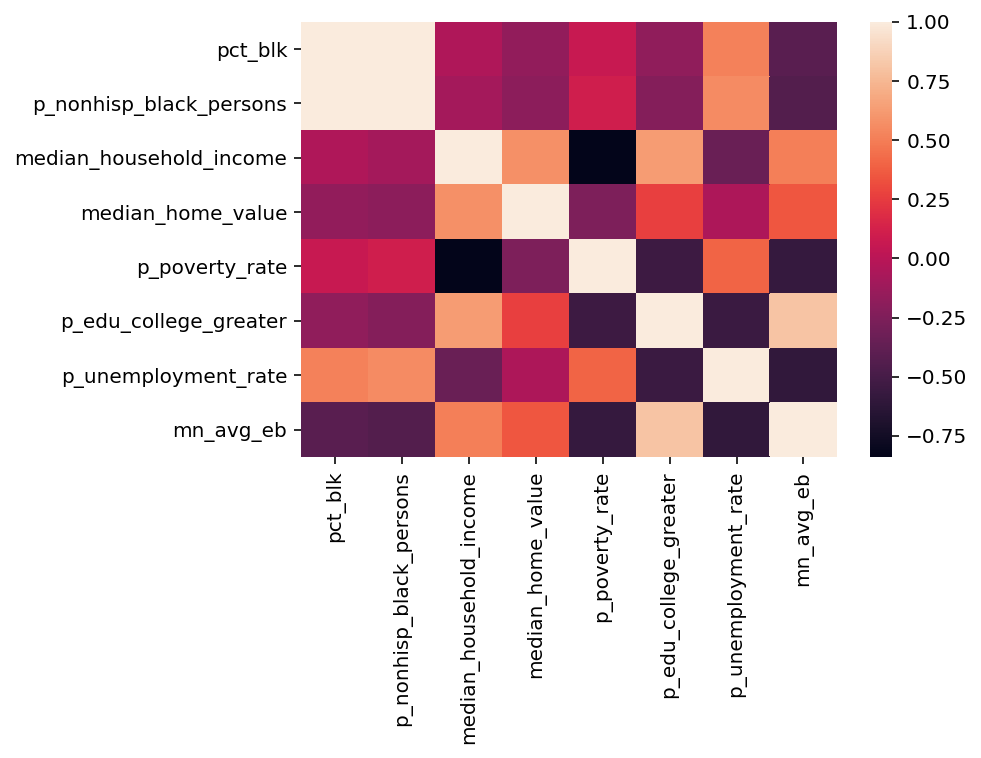

In [130]:
sns.heatmap(school_by_race[['pct_blk', 'p_nonhisp_black_persons',  "median_household_income", 'median_home_value',
        "p_poverty_rate",
        "p_edu_college_greater",
        "p_unemployment_rate",'mn_avg_eb']].corr())

In [129]:
school_by_race.columns

Index(['NCESSCH', 'LEAID', 'NAME', 'OPSTFIPS', 'STREET', 'CITY', 'STATE',
       'ZIP', 'STFIP', 'CNTY', 'NMCNTY', 'LOCALE', 'LAT', 'LON', 'CBSA',
       'NMCBSA', 'CBSATYPE', 'CSA', 'NMCSA', 'NECTA', 'NMNECTA', 'CD', 'SLDL',
       'SLDU', 'SCHOOLYEAR', 'geometry_x', 'ncessch', 'schoolname', 'fips',
       'stateabb', 'subgroup', 'gap_est', 'tot_asmts', 'cellcount', 'mn_asmts',
       'midgrd', 'mn_avg_ol', 'mn_grd_ol', 'mn_coh_ol', 'mn_mth_ol',
       'mn_avg_eb', 'mn_grd_eb', 'mn_coh_eb', 'mn_mth_eb', 'mn_avg_eb_se',
       'mn_grd_eb_se', 'mn_coh_eb_se', 'mn_mth_eb_se', 'mn_avg_ol_se',
       'mn_grd_ol_se', 'mn_coh_ol_se', 'mn_mth_ol_se', 'crdc_id', 'White',
       'Black', 'Hispanic', 'Asian', 'American Indian or Alaska Native',
       'Native Hawaiian or other Pacific Islander', 'Two or more races',
       'Total', 'SrcName', 'schnam', 'leaid', 'gslo', 'gshi', 'defacto',
       'stAbbrev', 'openEnroll', 'Shape_Leng', 'Shape_Area', 'level',
       'MultiBdy', 'geometry_y', 'pct_b

In [1]:
def read_geoda(dataset):

    geoda_base = f'https://geodacenter.github.io/data-and-lab/data/{dataset}.zip'

    # read in the file which is sometimes stored in a subdir
    try:
        df = gpd.read_file("zip+"+geoda_base)
    except Exception:
        df = gpd.read_file("zip+"+geoda_base+f"!{dataset}")
    return df
        

In [25]:
#libpysal.examples.load_example('Tampa1').get_file_list()

In [30]:
df = gpd.read_file(libpysal.examples.load_example('georgia').get_path('G_utm.shp'))

<AxesSubplot:>

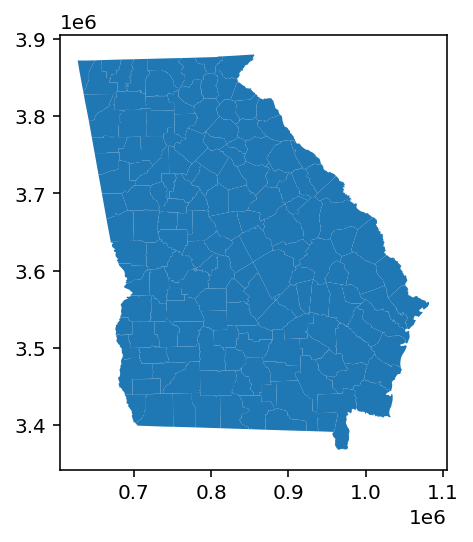

In [31]:
df.plot()

In [32]:
df.head()

,AREA,PERIMETER,G_UTM_,G_UTM_ID,Latitude,Longitud,TotPop90,PctRural,PctBach,PctEld,PctFB,PctPov,PctBlack,X,Y,AreaKey,geometry
0,1.331370e+09,207205.0,132,133,31.75339,-82.28558,15744,75.6,8.2,11.43,0.64,19.9,20.76,941396.6,3521764,13001,"POLYGON ((931869.062 3545540.500, 934111.625 3..."
1,8.929300e+08,154640.0,157,158,31.29486,-82.87474,6213,100.0,6.4,11.77,1.58,26.0,26.86,895553.0,3471916,13003,"POLYGON ((867016.312 3482416.000, 884309.375 3..."
2,7.434020e+08,130431.0,148,146,31.55678,-82.45115,9566,61.7,6.6,11.11,0.27,24.1,15.42,930946.4,3502787,13005,"POLYGON ((914656.875 3512190.000, 924718.375 3..."
3,9.053950e+08,185737.0,158,155,31.33084,-84.45401,3615,100.0,9.4,13.17,0.11,24.8,51.67,745398.6,3474765,13007,"POLYGON ((744258.625 3480598.500, 765025.062 3..."
4,6.941830e+08,151347.0,76,79,33.07193,-83.25085,39530,42.7,13.3,8.64,1.43,17.5,42.39,849431.3,3665553,13009,"POLYGON ((832974.188 3677273.500, 834048.688 3..."


In [8]:
df = read_geoda('Lansing1')

DriverError: '/vsizip/vsicurl/https://geodacenter.github.io/data-and-lab/data/Lansing1.zip/Lansing1' does not exist in the file system, and is not recognized as a supported dataset name.

<AxesSubplot:>

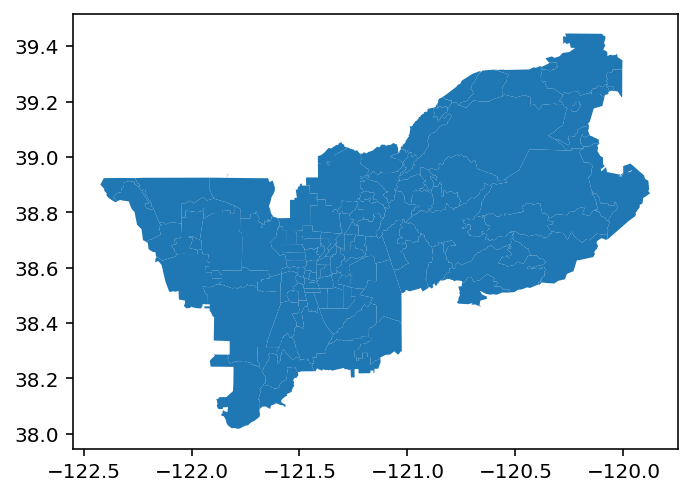

In [274]:
df.plot()

In [23]:
test = gpd.read_file('zip:///Users/knaaptime/pysal_data/Tampa1/TampaMSA/tampa_final_census2.gpkg.zip')

In [24]:
test

,FIPS,MSA,TOT_POP,POP_16,POP_65,WHITE_,BLACK_,ASIAN_,HISP_,MULTI_RA,...,EMP_FEM,OCC_MAN,OCC_OFF1,OCC_INFO,HH_INC,POV_POP,POV_TOT,HSG_VAL,POLYID,geometry
0,12053040700,Tampa,4890,1116,800,4433,50,4,328,75,...,917,108,220,7,30824,4858,494,70700,0,"POLYGON ((-82.48868 28.66547, -82.48833 28.665..."
1,12053041600,Tampa,4750,440,1898,4577,23,3,85,58,...,648,62,318,11,33769,4728,368,86700,1,"POLYGON ((-82.57141 28.51898, -82.57176 28.518..."
2,12053040201,Tampa,2300,424,399,1975,91,16,63,137,...,437,84,155,14,32188,2287,351,89400,2,"POLYGON ((-82.22381 28.57333, -82.22402 28.574..."
3,12053040600,Tampa,4872,1012,865,4511,104,19,86,41,...,883,102,218,7,31804,4867,628,69100,3,"MULTIPOLYGON (((-82.48157 28.56288, -82.48157 ..."
4,12053040202,Tampa,5712,1335,1067,4993,448,10,212,28,...,1104,131,225,23,35642,5680,877,59600,4,"POLYGON ((-82.23699 28.52319, -82.23710 28.523..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
542,12103028002,Tampa,4077,442,1164,3896,10,43,92,23,...,836,79,655,22,53500,4070,251,219000,542,"MULTIPOLYGON (((-82.72900 27.70622, -82.72972 ..."
543,12057014002,Tampa,1408,231,523,1044,0,14,347,0,...,170,12,20,0,31821,1408,169,52900,543,"POLYGON ((-82.52454 27.64575, -82.52440 27.645..."
544,12057014003,Tampa,874,194,99,773,0,27,52,0,...,237,26,113,12,64625,874,60,119500,544,"POLYGON ((-82.38374 27.64723, -82.38672 27.646..."
545,12103020103,Tampa,7403,497,2466,6954,183,0,206,43,...,1416,40,1239,82,70901,7391,329,166900,545,"MULTIPOLYGON (((-82.70563 27.71390, -82.70576 ..."


In [35]:
tokyo = gpd.read_file('zip:///Users/knaaptime/Dropbox/projects/libpysal/libpysal/examples/tokyo.zip!/tokyo/tokyomet262.shp')

In [19]:
gpd.read_file('/Users/knaaptime/Dropbox/projects/libpysal/libpysal/examples/snow_maps/Soho_Network.shp')

,Id,geometry
0,0,"LINESTRING (-15664.521 6712578.656, -15941.805..."
1,0,"LINESTRING (-15708.971 6712314.072, -15547.046..."
2,0,"LINESTRING (-15556.695 6712381.737, -15696.271..."
3,0,"LINESTRING (-15708.971 6712314.072, -15793.638..."
4,0,"LINESTRING (-15793.638 6712263.272, -15822.213..."
...,...,...
113,0,"LINESTRING (-14937.373 6712420.146, -14959.179..."
114,0,"LINESTRING (-14916.278 6712598.349, -14972.938..."
115,0,"LINESTRING (-15089.640 6712765.784, -15163.438..."
116,0,"LINESTRING (-15144.609 6712732.789, -15174.021..."


In [38]:
libpysal.examples.available()

                      Name                                                                                                                                                                                                                                       Description  Installed
0                    10740                                                                                                                Albuquerque, New Mexico, Census 2000 Tract Data. 10740 is the Core Based Statistical Area (CBSA) code for Albuquerque, New Mexico.       True
1                   AirBnB                                                                                                                                                                                              Airbnb rentals, socioeconomics, and crime in Chicago       True
2                  Atlanta                                                                                                                                      

In [52]:
libpysal.examples.explain('10740')

10740
=====

Albuquerque, New Mexico, Census 2000 Tract Data. 10740 is the Core Based Statistical Area (CBSA) code for Albuquerque, New Mexico.
-----------------------------------------------

* 10740.dbf: attribute data. (k=5) 
* 10740.shp: shapefile. (n=195)
* 10740.shx: spatial index.
* 10740_queen.gal: queen contiguity weights in GAL format.
* 10740_rook.gal: rook contiguity weights in GAL format.



In [59]:
pd.read_csv('zip:///Users/knaaptime/Dropbox/projects/libpysal/libpysal/examples/stl.zip!stl/stl_hom.csv')

IsADirectoryError: [Errno 21] Is a directory: '/Users/knaaptime/Dropbox/projects/geosnap4ed/notebooks'

In [53]:
!pip install fsspec 

     |████████████████████████████████| 98 kB 3.8 MB/s eta 0:00:01


In [60]:
pwd

'/Users/knaaptime/Dropbox/projects/geosnap4ed/notebooks'

In [62]:
import rasterio
import rasterio.features
import rasterio.warp

with rasterio.open('../../tobler/nlcd_2011.tif') as dataset:

    # Read the dataset's valid data mask as a ndarray.
    mask = dataset.dataset_mask()

    # Extract feature shapes and values from the array.
    for geom, val in rasterio.features.shapes(
            mask, transform=dataset.transform):

        # Transform shapes from the dataset's own coordinate
        # reference system to CRS84 (EPSG:4326).
        geom = rasterio.warp.transform_geom(
            dataset.crs, 'EPSG:4326', geom, precision=6)

        # Print GeoJSON shapes to stdout.
        print(geom)

{'type': 'Polygon', 'coordinates': [[[-130.232828, 48.707396], [-119.786105, 21.742308], [-73.594596, 22.076731], [-63.672192, 49.177063], [-130.232828, 48.707396]]]}


In [63]:
geom['type']

'Polygon'

In [64]:
import shapely

In [67]:
shapely.wkt.loads(str(geom))

ParseException: Unknown type: '{'TYPE':'


WKTReadingError: Could not create geometry because of errors while reading input.

In [68]:
str(geom)

"{'type': 'Polygon', 'coordinates': [[[-130.232828, 48.707396], [-119.786105, 21.742308], [-73.594596, 22.076731], [-63.672192, 49.177063], [-130.232828, 48.707396]]]}"

KeyError: 0

In [1]:
import pysal

In [74]:
pysal.model.mgwr.gwr

AttributeError: module 'pysal' has no attribute 'model'

In [75]:
import pysal

In [2]:
pysal.federation_hierarchy

{'explore': ['esda',
  'giddy',
  'segregation',
  'pointpats',
  'inequality',
  'spaghetti'],
 'model': ['spreg', 'spglm', 'tobler', 'spint', 'mgwr', 'spvcm', 'access'],
 'viz': ['splot', 'mapclassify'],
 'lib': ['libpysal']}

In [3]:
pysal.__version__

'2.3.0'

In [4]:
pysal.versions

In [1]:
import sklearn

In [3]:
sklearn.cluster.sp

<module 'sklearn' from '/Users/knaaptime/anaconda3/envs/tobler/lib/python3.8/site-packages/sklearn/__init__.py'>

In [1]:
import geopandas as gpd

In [8]:
%timeit
t = gpd.read_file('zip:///Users/knaaptime/Dropbox/projects/geosnap4ed/data/nces/districts/EDGE_SCHOOLDISTRICT_TL19_SY1819.zip')

In [7]:
t.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 13315 entries, 0 to 13314
Data columns (total 19 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   STATEFP     13315 non-null  object  
 1   ELSDLEA     1946 non-null   object  
 2   SCSDLEA     482 non-null    object  
 3   UNSDLEA     10887 non-null  object  
 4   GEOID       13315 non-null  object  
 5   NAME        13315 non-null  object  
 6   LSAD        13315 non-null  object  
 7   LOGRADE     13315 non-null  object  
 8   HIGRADE     13315 non-null  object  
 9   MTFCC       13315 non-null  object  
 10  SDTYP       256 non-null    object  
 11  FUNCSTAT    13315 non-null  object  
 12  ALAND       13315 non-null  float64 
 13  AWATER      13315 non-null  float64 
 14  INTPTLAT    13315 non-null  object  
 15  INTPTLON    13315 non-null  object  
 16  GEO_YEAR    13315 non-null  object  
 17  SCHOOLYEAR  13315 non-null  object  
 18  geometry    13315 non-null  geometry
d

In [4]:
t.to_parquet("/Users/knaaptime/Downloads/nces_test.parquet")

<ipython-input-4-5956a934901a>:1: UserWarning: this is an initial implementation of Parquet/Feather file support and associated metadata.  This is tracking version 0.1.0 of the metadata specification at https://github.com/geopandas/geo-arrow-spec

This metadata specification does not yet make stability promises.  We do not yet recommend using this in a production setting unless you are able to rewrite your Parquet/Feather files.

To further ignore this warning, you can do: 
import warnings; warnings.filterwarnings('ignore', message='.*initial implementation of Parquet.*')
  t.to_parquet("/Users/knaaptime/Downloads/nces_test.parquet")


In [12]:
import osmnx as ox

In [28]:
roads = ox.graph_from_place('Chicago, IL')

In [29]:
_, roads  = ox.graph_to_gdfs(roads)

<AxesSubplot:>

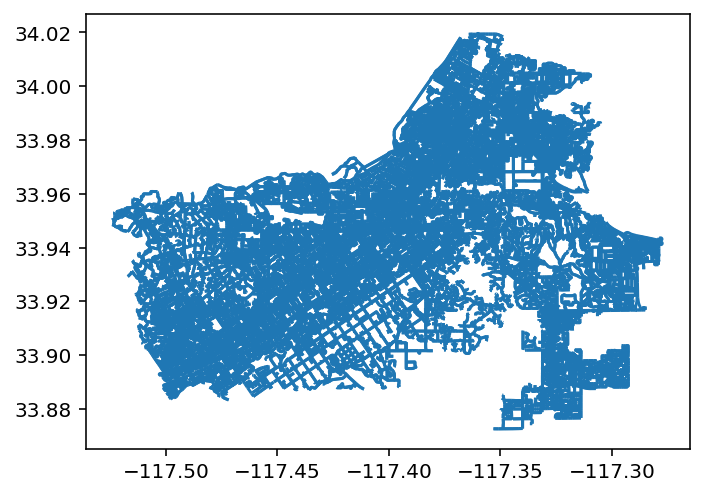

In [18]:
roads.plot()

In [53]:
res_roads = roads[roads.highway=='residential']

In [54]:
res_roads = res_roads.to_crs(3435)

In [59]:
chi_polys = ox.geometries_from_place('Chicago, IL',tags={'highway':'residential'}, buffer_dist=100)

/Users/knaaptime/anaconda3/envs/geosnap/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<AxesSubplot:>

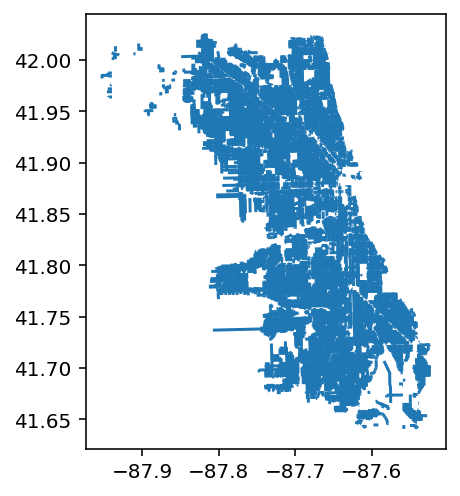

In [61]:
chi_polys.plot()

In [57]:
polys = gpd.GeoDataFrame(gpd.GeoSeries(res_roads.unary_union).buffer(300), name='geometry')

TypeError: __init__() got an unexpected keyword argument 'name'

In [48]:
res_roads['geometry'] = res_roads.buffer(300)

In [52]:
gpd.GeoDataFrame(gpd.GeoSeries([res_roads.unary_union], name='geometry')).to_file("/Users/knaaptime/Desktop/roads.shp")

In [38]:
res_polys = res_roads.buffer(300)

AttributeError: No geometry data set yet (expected in column 'geometry'.)

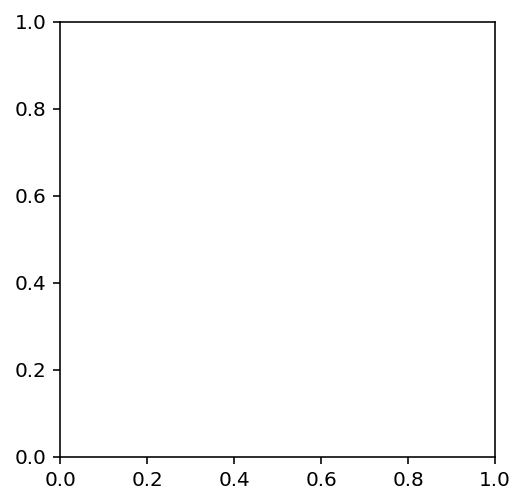

In [45]:
gpd.GeoDataFrame(res_polys)

In [37]:
res_roads.buffer(300).to_file("/Users/knaaptime/Desktop/roads.shp")

In [1]:
import fsspec

In [3]:
import geopandas as gpd
import pandas as pd
import tempfile

In [61]:
#with tempfile.TemporaryDirectory() as temp_path:
temp_path = tempfile.mkdtemp()
of = fsspec.open_files('simplecache::zip://SABS_1516*::https://nces.ed.gov/programs/edge/data/SABS_1516.zip',
                  simplecache={'cache_storage': temp_path})
file = os.listdir(temp_path)
print(file)
gdf = gpd.read_file('zip://'+temp_path+'/SABS_1516.zip', driver='ESRI Shapefile')


[]


DriverError: '/vsizip//var/folders/25/yq95gqxj1fz_t8zj565ck0pm0000gn/T/tmp1lisq4nx/SABS_1516.zip' does not exist in the file system, and is not recognized as a supported dataset name.

In [5]:
import os

In [62]:
of

<List of 0 OpenFile instances>

In [55]:
of

<List of 1 OpenFile instances>

In [60]:
of[0].read()

AttributeError: 'OpenFile' object has no attribute 'read'

In [1]:
from geosnap import datasets

In [2]:
msas = datasets.msas()

In [5]:
msas.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 945 entries, 0 to 944
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   geoid     945 non-null    object  
 1   name      945 non-null    object  
 2   type      945 non-null    object  
 3   geometry  945 non-null    geometry
dtypes: geometry(1), object(3)
memory usage: 29.7+ KB


In [8]:
msas[msas['type'].str.contains('Metro')]

,geoid,name,type,geometry
2,10180,"Abilene, TX",Metro Area,"POLYGON ((-100.14654 32.52279, -100.14642 32.5..."
6,10380,"Aguadilla-Isabela, PR",Metro Area,"POLYGON ((-67.20794 18.44228, -67.20844 18.443..."
7,10420,"Akron, OH",Metro Area,"POLYGON ((-81.39169 41.34827, -81.39164 41.348..."
9,10500,"Albany, GA",Metro Area,"POLYGON ((-84.45040 31.62187, -84.45045 31.621..."
10,10540,"Albany, OR",Metro Area,"POLYGON ((-123.25099 44.55198, -123.25240 44.5..."
...,...,...,...,...
937,49420,"Yakima, WA",Metro Area,"POLYGON ((-121.42324 46.49274, -121.42330 46.4..."
939,49620,"York-Hanover, PA",Metro Area,"POLYGON ((-77.05440 40.02321, -77.05441 40.023..."
940,49660,"Youngstown-Warren-Boardman, OH-PA",Metro Area,"POLYGON ((-81.00229 41.13419, -81.00232 41.145..."
941,49700,"Yuba City, CA",Metro Area,"POLYGON ((-121.62376 39.29562, -121.62339 39.2..."


In [7]:
from geosnap.io import _fipstable

In [12]:
names= (_fipstable[_fipstable["FIPS Code"].isin(states)]["State Abbreviation"]
            .str.lower()
            .tolist())

KeyError: "None of [Index(['02', '01', '05', '60', '04', '06', '07', '08', '09', '11', '10', '12',\n       '64', '13', '66', '15', '19', '16', '17', '18', '20', '21', '22', '25',\n       '24', '23', '68', '26', '27', '29', '69', '28', '30', '37', '38', '31',\n       '33', '34', '35', '32', '36', '39', '40', '41', '42', '72', '70', '44',\n       '45', '46', '47', '48', '49', '74', '51', '78', '50', '53', '55', '54',\n       '56'],\n      dtype='object')] are in the [columns]"

In [18]:
n = _fipstable[_fipstable['FIPS Code'] != '72']

In [19]:
n == _fipstable

ValueError: Can only compare identically-labeled DataFrame objects

In [20]:
n.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 60 entries, 0 to 60
Data columns (total 3 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   State Abbreviation  60 non-null     object
 1   FIPS Code           60 non-null     object
 2   State Name          60 non-null     object
dtypes: object(3)
memory usage: 1.9+ KB


In [8]:
_fipstable

,State Abbreviation,FIPS Code,State Name
0,AK,02,ALASKA
1,AL,01,ALABAMA
2,AR,05,ARKANSAS
3,AS,60,AMERICAN SAMOA
4,AZ,04,ARIZONA
...,...,...,...
56,VT,50,VERMONT
57,WA,53,WASHINGTON
58,WI,55,WISCONSIN
59,WV,54,WEST VIRGINIA


In [22]:
from geosnap import datasets

In [25]:
msa_counties =  datasets.msa_definitions()["CBSA Code"]["stcofips"].tolist()

KeyError: 'stcofips'

In [33]:
pr_metros = set(datasets.msa_definitions()[datasets.msa_definitions()['CBSA Title'].str.contains('PR')]['CBSA Code'].tolist())

In [34]:
pr_metros

{'10380',
 '11640',
 '17620',
 '17640',
 '25020',
 '27580',
 '32420',
 '38660',
 '41900',
 '41980',
 '42180',
 '49500'}

In [35]:
'17620' in pr_metros

True

In [1]:
from geosnap import Community

In [2]:
test = Community.from_lodes(msa_fips='10380')

Exception: geosnap does not yet include built-in data for Puerto Rico

In [2]:
test = Community.from_lodes(msa_fips='47900')

Loading manifest: 100%|██████████| 57/57 [00:00<00:00, 28.9k/s]


In [ ]:
test.gdf

In [3]:
test = Community.from_census(msa_fips='10380')

Exception: geosnap does not yet include built-in data for Puerto Rico

In [3]:
test = Community.from_census(state_fips='12')

<AxesSubplot:>

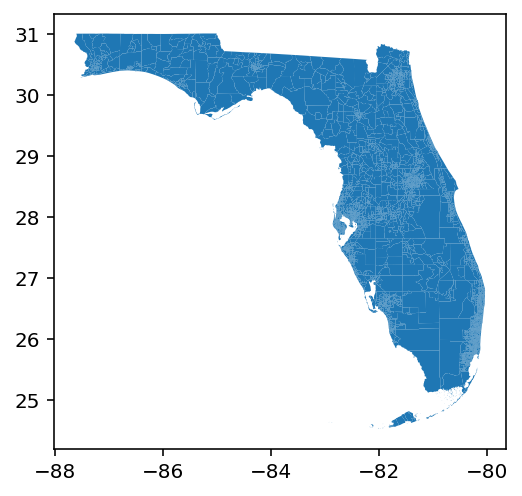

In [8]:
test.gdf[test.gdf.year==2010].plot()

In [5]:
name = 'gep'

In [7]:
name.startswith('g')

True